<a href="https://colab.research.google.com/github/Anjasfedo/computer-vision/blob/main/UIEB_preprocess.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Progress
- Memilih 3 gambar blur dengar resolusi diatas 500x500 > didapat ["515_img_.png", "858_img_.png", "469_img_.png"]
- Ubah resulusi gambar menjadi 500x500, agar sama rata >

# Import Dataset

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("larjeck/uieb-dataset-reference")

print("Path to dataset files:", path)

100%|██████████| 785M/785M [00:34<00:00, 23.7MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/larjeck/uieb-dataset-reference/versions/1


# Choose Image

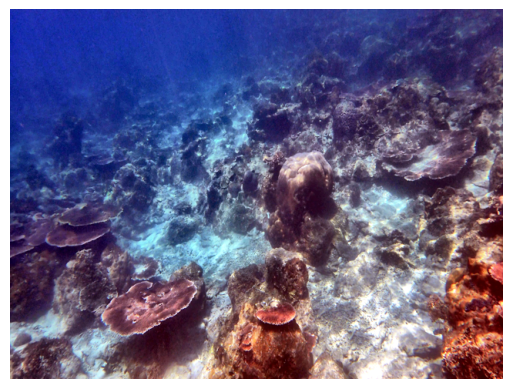

(480, 640, 3)

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Ganti dengan path gambar yang ingin dibaca
image_path = path+"/reference-890/120_img_.png"

# Membaca gambar dengan OpenCV
image = cv2.imread(image_path)

# Konversi dari BGR ke RGB (karena OpenCV membaca dalam format BGR)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Menampilkan gambar
plt.imshow(image)
plt.axis("off")
plt.show()

image.shape

(670, 1280, 3)
(366, 485, 3)
(768, 1024, 3)


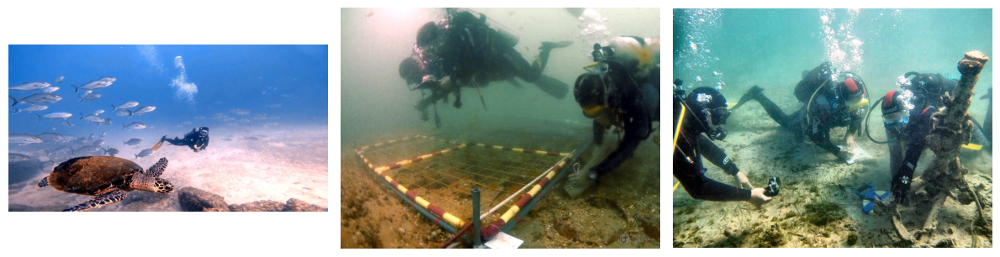

In [ ]:
import os
import cv2
import glob
import random
import matplotlib.pyplot as plt

image_folder = os.path.join(path, "reference-890")  # Pastikan path ini benar

# Mencari semua gambar dalam folder (format PNG, bisa ditambah format lain jika perlu)
image_files = glob.glob(os.path.join(image_folder, "*.png"))

# Pastikan ada gambar dalam folder sebelum memilih secara acak
if len(image_files) == 0:
    print("Tidak ada gambar yang ditemukan dalam folder!")
else:
    # Pilih 3 gambar secara acak
    selected_images = random.sample(image_files, 3)

    # Menampilkan 3 gambar
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    for ax, img_path in zip(axes, selected_images):
        # Membaca gambar dengan OpenCV
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Konversi dari BGR ke RGB

        print(image.shape)

        # Menampilkan gambar
        ax.imshow(image)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

Nama Gambar: 413_img_.png
(480, 640, 3)
Nama Gambar: 603_img_.png
(375, 500, 3)
Nama Gambar: 374_img_.png
(720, 1280, 3)


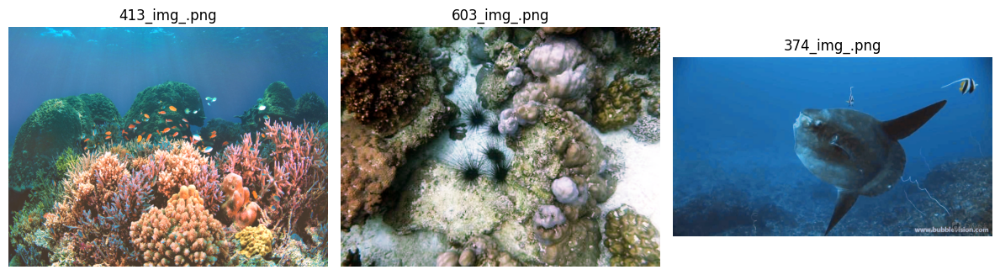

Gambar yang dipilih: ['413_img_.png', '603_img_.png', '374_img_.png']


In [ ]:
import os
import cv2
import glob
import random
import matplotlib.pyplot as plt

def get_random_images(image_folder, num_images=3):
    """
    Fungsi untuk mengambil beberapa gambar secara acak dari folder dan menampilkan hasilnya.

    Args:
        image_folder (str): Path folder yang berisi gambar.
        num_images (int): Jumlah gambar yang ingin dipilih (default = 3).

    Returns:
        list: Daftar nama file gambar yang dipilih.
    """
    # Mencari semua gambar dalam folder (format PNG, bisa ditambah format lain)
    image_files = glob.glob(os.path.join(image_folder, "*.png"))

    # Jika tidak ada gambar dalam folder
    if len(image_files) == 0:
        print("Tidak ada gambar yang ditemukan dalam folder!")
        return []

    # Pilih `num_images` gambar secara acak
    selected_images = random.sample(image_files, min(num_images, len(image_files)))

    # Menampilkan gambar
    fig, axes = plt.subplots(1, len(selected_images), figsize=(4 * len(selected_images), 4))

    # Jika hanya satu gambar, ubah axes menjadi list agar dapat diiterasi
    if len(selected_images) == 1:
        axes = [axes]

    image_names = []  # Menyimpan nama file gambar

    for ax, img_path in zip(axes, selected_images):
        image_name = os.path.basename(img_path)  # Mengambil nama file
        image_names.append(image_name)
        print(f"Nama Gambar: {image_name}")

        # Membaca dan menampilkan gambar
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Konversi dari BGR ke RGB
        print(image.shape)

        ax.imshow(image)
        ax.set_title(image_name)  # Menampilkan nama gambar di atas gambar
        ax.axis("off")

    plt.tight_layout()
    plt.show()

    return image_names  # Mengembalikan daftar nama file gambar

# Contoh pemanggilan fungsi
image_folder = os.path.join(path, "reference-890")  # Ganti sesuai path dataset Anda
image_names = get_random_images(image_folder, num_images=3)

# Print hasil return
print("Gambar yang dipilih:", image_names)


Nama Gambar: 1407.png
Ukuran: 1280x720
Nama Gambar: 718_img_.png
Ukuran: 828x621
Nama Gambar: 469_img_.png
Ukuran: 1024x682


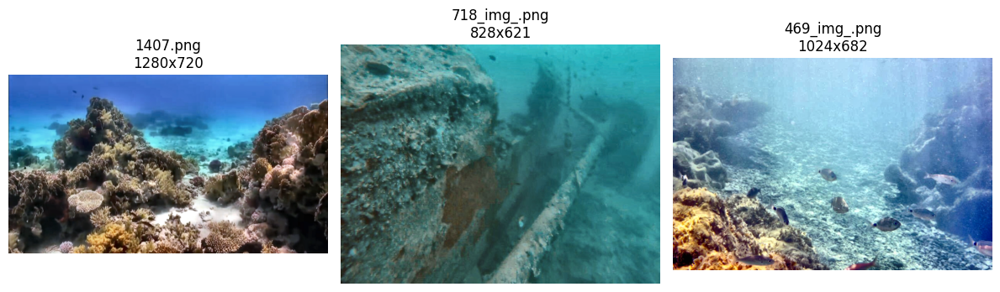

Gambar yang dipilih: ['1407.png', '718_img_.png', '469_img_.png']


In [ ]:
import os
import cv2
import glob
import random
import matplotlib.pyplot as plt

def get_random_images(image_folder, num_images=3, min_size=500):
    """
    Fungsi untuk mengambil beberapa gambar secara acak dari folder dan menampilkan hasilnya.
    Hanya memilih gambar dengan ukuran minimal min_size x min_size.

    Args:
        image_folder (str): Path folder yang berisi gambar.
        num_images (int): Jumlah gambar yang ingin dipilih (default = 3).
        min_size (int): Ukuran minimal untuk lebar dan tinggi gambar (default = 500).

    Returns:
        list: Daftar nama file gambar yang dipilih.
    """
    # Mencari semua gambar dalam folder (format PNG, bisa ditambah format lain)
    image_files = glob.glob(os.path.join(image_folder, "*.png"))

    # Jika tidak ada gambar dalam folder
    if len(image_files) == 0:
        print("Tidak ada gambar yang ditemukan dalam folder!")
        return []

    # Filter gambar berdasarkan ukuran minimal
    valid_images = []
    for img_path in image_files:
        image = cv2.imread(img_path)
        if image is not None:
            height, width = image.shape[:2]
            if height >= min_size and width >= min_size:
                valid_images.append(img_path)

    # Cek apakah ada gambar yang memenuhi syarat
    if len(valid_images) == 0:
        print(f"Tidak ada gambar dengan ukuran minimal {min_size}x{min_size}.")
        return []

    # Pilih gambar secara acak dari gambar valid
    selected_images = random.sample(valid_images, min(num_images, len(valid_images)))

    # Menampilkan gambar
    fig, axes = plt.subplots(1, len(selected_images), figsize=(4 * len(selected_images), 4))

    # Jika hanya satu gambar, ubah axes menjadi list agar dapat diiterasi
    if len(selected_images) == 1:
        axes = [axes]

    image_names = []  # Menyimpan nama file gambar

    for ax, img_path in zip(axes, selected_images):
        image_name = os.path.basename(img_path)  # Mengambil nama file
        image_names.append(image_name)
        print(f"Nama Gambar: {image_name}")

        # Membaca dan menampilkan gambar
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Konversi dari BGR ke RGB
        height, width = image.shape[:2]
        print(f"Ukuran: {width}x{height}")

        ax.imshow(image)
        ax.set_title(f"{image_name}\n{width}x{height}")  # Menampilkan nama dan ukuran gambar
        ax.axis("off")

    plt.tight_layout()
    plt.show()

    return image_names  # Mengembalikan daftar nama file gambar

# Contoh pemanggilan fungsi
image_folder = os.path.join(path, "reference-890")  # Ganti sesuai path dataset Anda
image_names = get_random_images(image_folder, num_images=3, min_size=500)

# Print hasil return
print("Gambar yang dipilih:", image_names)


(768, 1024, 3)
(783, 856, 3)
(682, 1024, 3)


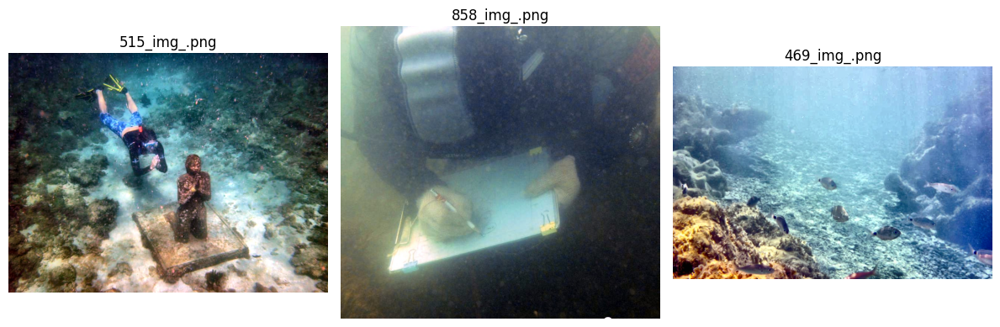

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

def show_images(image_folder, image_names):
    """
    Fungsi untuk menampilkan 3 gambar berdasarkan nama file.

    Args:
        image_folder (str): Path folder tempat gambar disimpan.
        image_names (list): Daftar nama file gambar yang akan ditampilkan (harus 3 gambar).
    """
    if len(image_names) != 3:
        print("Harap berikan tepat 3 nama file gambar.")
        return

    # Setup plot
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    for ax, image_name in zip(axes, image_names):
        # Membuat path lengkap ke gambar
        img_path = os.path.join(image_folder, image_name)

        # Membaca gambar
        image = cv2.imread(img_path)
        if image is None:
            print(f"Gambar tidak ditemukan atau gagal dibaca: {image_name}")
            continue

        # Konversi BGR ke RGB untuk menampilkan dengan matplotlib
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        print(image.shape)

        # Menampilkan gambar
        ax.imshow(image)
        ax.set_title(image_name)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

# Contoh pemanggilan fungsi
image_folder = os.path.join(path, "reference-890")  # Path folder gambar

# Contoh daftar nama gambar (ganti dengan nama gambar asli)
image_names = ["515_img_.png", "858_img_.png", "469_img_.png"]

# Panggil fungsi untuk menampilkan gambar
show_images(image_folder, image_names)


# Change resolution into 500x500

In [ ]:
import os
import cv2

def resize_and_save_images_to_content(image_folder, image_names, target_size=(500, 500)):
    """
    Fungsi untuk me-resize gambar ke target_size dan menyimpannya ke /content/ dengan akhiran '_500x500'.

    Args:
        image_folder (str): Path folder tempat gambar asli.
        image_names (list): Daftar nama file gambar yang akan di-resize.
        target_size (tuple): Ukuran target untuk resize gambar (default: 500x500).
    """
    # Folder penyimpanan di /content/
    save_folder = "/content/"
    os.makedirs(save_folder, exist_ok=True)

    for image_name in image_names:
        # Membuat path lengkap ke gambar
        img_path = os.path.join(image_folder, image_name)

        # Membaca gambar
        image = cv2.imread(img_path)
        if image is None:
            print(f"Gagal membaca gambar: {image_name}")
            continue

        # Resize gambar ke target_size (500x500)
        resized_image = cv2.resize(image, target_size)

        # Membuat nama file baru dengan akhiran '_500x500'
        name, ext = os.path.splitext(image_name)
        new_image_name = f"{name}_500x500{ext}"
        save_path = os.path.join(save_folder, new_image_name)

        # Simpan gambar yang sudah di-resize
        cv2.imwrite(save_path, resized_image)
        print(f"Gambar disimpan: {save_path}")

    print("Semua gambar berhasil di-resize dan disimpan di /content/.")

# Contoh pemanggilan fungsi
image_folder = os.path.join(path, "reference-890")  # Path folder gambar asli

# Daftar nama gambar yang ingin di-resize
image_names = ["515_img_.png", "858_img_.png", "469_img_.png"]

# Panggil fungsi untuk resize dan simpan gambar ke /content/
resize_and_save_images_to_content(image_folder, image_names, target_size=(500, 500))


Gambar disimpan: /content/515_img__500x500.png
Gambar disimpan: /content/858_img__500x500.png
Gambar disimpan: /content/469_img__500x500.png
Semua gambar berhasil di-resize dan disimpan di /content/.


(500, 500, 3)
(500, 500, 3)
(500, 500, 3)


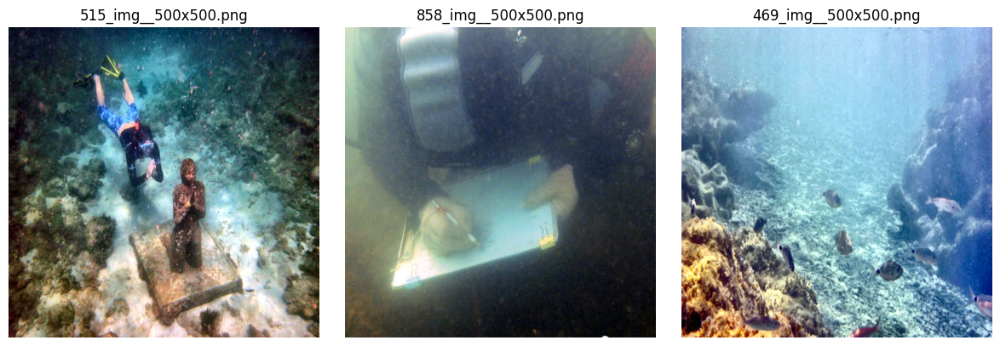

In [ ]:
# Contoh daftar nama gambar (ganti dengan nama gambar asli)
resized_image_names = ["515_img__500x500.png", "858_img__500x500.png", "469_img__500x500.png"]

# Panggil fungsi untuk menampilkan gambar
show_images("/content/", resized_image_names)

# Preprocessing

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

def apply_clahe(image):
    """Terapkan CLAHE (Contrast Limited Adaptive Histogram Equalization)."""
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(9, 9))
    cl = clahe.apply(l)

    merged = cv2.merge((cl, a, b))
    return cv2.cvtColor(merged, cv2.COLOR_LAB2BGR)

def apply_histogram_equalization(image):
    """Terapkan Histogram Equalization pada channel Luminance."""
    img_yuv = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
    img_yuv[:, :, 0] = cv2.equalizeHist(img_yuv[:, :, 0])
    return cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR)

def apply_adaptive_histogram_equalization(image):
    """Terapkan Adaptive Histogram Equalization menggunakan CLAHE."""
    return apply_clahe(image)

def apply_sharpening(image):
    """Terapkan High Pass Filter (Sharpening) menggunakan kernel sharpening."""
    kernel = np.array([
        [-1, -1, -1, -1, -1, -1, -1, -1, -1],
        [-1,  2,  2,  2,  2,  2,  2,  2, -1],
        [-1,  2,  4,  4,  4,  4,  4,  2, -1],
        [-1,  2,  4,  8,  8,  8,  4,  2, -1],
        [-1,  2,  4,  8, 16,  8,  4,  2, -1],
        [-1,  2,  4,  8,  8,  8,  4,  2, -1],
        [-1,  2,  4,  4,  4,  4,  4,  2, -1],
        [-1,  2,  2,  2,  2,  2,  2,  2, -1],
        [-1, -1, -1, -1, -1, -1, -1, -1, -1]
    ], dtype=np.float32)  # Kernel sharpening ukuran 9x9

    sharpened = cv2.filter2D(image, -1, kernel)  # Terapkan kernel sharpening
    return cv2.addWeighted(image, 1.5, sharpened, -0.5, 0)  # Gabungkan dengan gambar asli


def apply_smoothing(image):
    """Terapkan Low Pass Filter (Gaussian Blur) untuk smoothing."""
    return cv2.GaussianBlur(image, (9, 9), 0)

def process_and_show_image(image_folder, image_name):
    """
    Terapkan berbagai algoritma pada satu gambar dan tampilkan hasilnya.
    """
    filters = {
        "Original": lambda x: x,
        "CLAHE": apply_clahe,
        "Histogram Equalization": apply_histogram_equalization,
        "Adaptive HE": apply_adaptive_histogram_equalization,
        "Sharpening (Sobel)": apply_sharpening,
        "Smoothing (Gaussian Blur)": apply_smoothing
    }

    # Membaca gambar
    img_path = os.path.join(image_folder, image_name)
    image = cv2.imread(img_path)

    if image is None:
        print(f"Gagal membaca gambar: {image_name}")
        return  # Menghentikan fungsi jika gambar tidak ditemukan

    # Setup plot untuk masing-masing filter
    plt.figure(figsize=(20, 10))
    plt.suptitle(f"Processing: {image_name}", fontsize=16)

    for idx, (filter_name, filter_func) in enumerate(filters.items()):
        processed_image = filter_func(image)

        # Konversi BGR ke RGB untuk matplotlib
        processed_image_rgb = cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB)

        plt.subplot(2, 3, idx + 1)
        plt.imshow(processed_image_rgb)
        plt.title(filter_name)
        plt.axis("off")

    plt.tight_layout()
    plt.show()

image_folder = "/content/"
resized_image_names = ["515_img__500x500.png", "858_img__500x500.png", "469_img__500x500.png"]

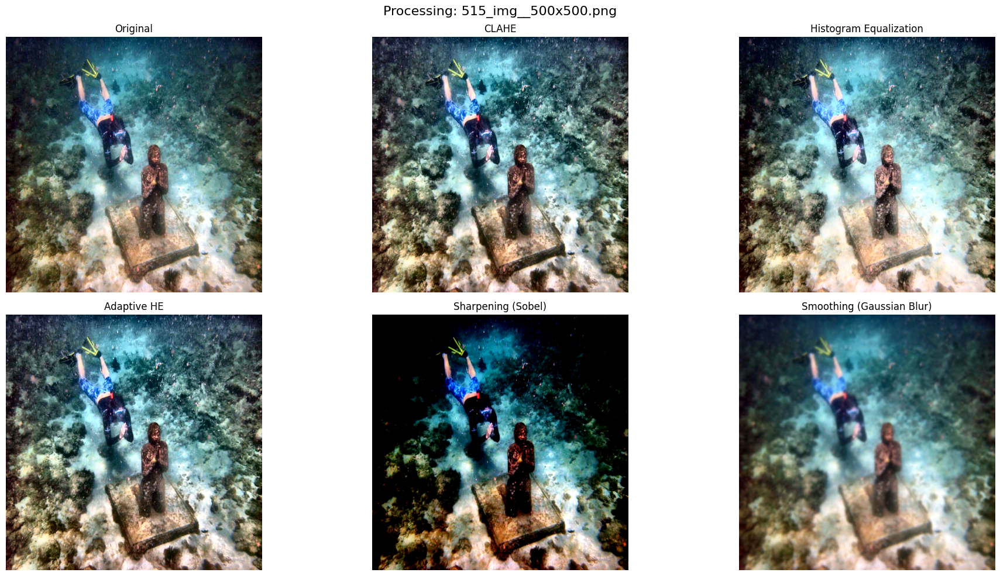

In [ ]:
process_and_show_image(image_folder, resized_image_names[0])

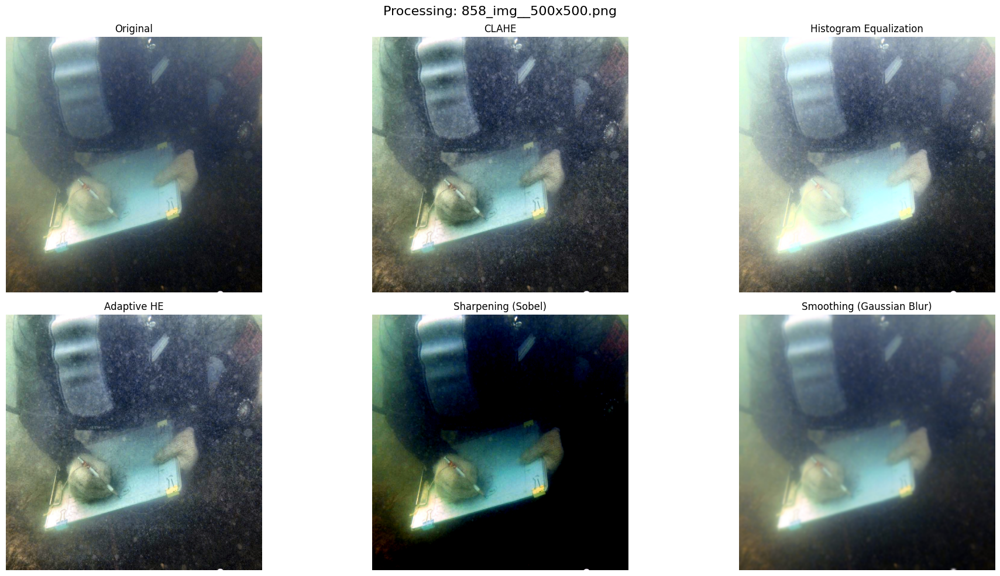

In [ ]:
process_and_show_image(image_folder, resized_image_names[1])

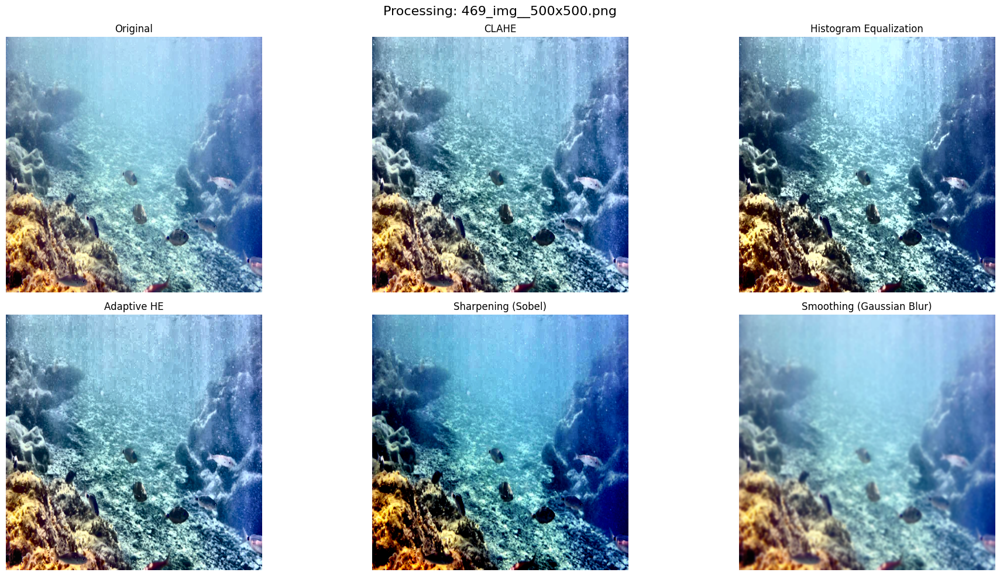

In [ ]:
process_and_show_image(image_folder, resized_image_names[2])

# Preprocess with save

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

def apply_clahe(image):
    """Terapkan CLAHE (Contrast Limited Adaptive Histogram Equalization)."""
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(9, 9))
    cl = clahe.apply(l)

    merged = cv2.merge((cl, a, b))
    return cv2.cvtColor(merged, cv2.COLOR_LAB2BGR)

def apply_histogram_equalization(image):
    """Terapkan Histogram Equalization pada channel Luminance."""
    img_yuv = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
    img_yuv[:, :, 0] = cv2.equalizeHist(img_yuv[:, :, 0])
    return cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR)

def apply_adaptive_histogram_equalization(image):
    """Terapkan Adaptive Histogram Equalization menggunakan CLAHE."""
    return apply_clahe(image)

def apply_sharpening(image):
    """Terapkan High Pass Filter (Sharpening) menggunakan kernel sharpening."""
    kernel = np.array([
        [-1, -1, -1, -1, -1, -1, -1, -1, -1],
        [-1,  2,  2,  2,  2,  2,  2,  2, -1],
        [-1,  2,  4,  4,  4,  4,  4,  2, -1],
        [-1,  2,  4,  8,  8,  8,  4,  2, -1],
        [-1,  2,  4,  8, 16,  8,  4,  2, -1],
        [-1,  2,  4,  8,  8,  8,  4,  2, -1],
        [-1,  2,  4,  4,  4,  4,  4,  2, -1],
        [-1,  2,  2,  2,  2,  2,  2,  2, -1],
        [-1, -1, -1, -1, -1, -1, -1, -1, -1]
    ], dtype=np.float32)  # Kernel sharpening ukuran 9x9

    sharpened = cv2.filter2D(image, -1, kernel)  # Terapkan kernel sharpening
    return cv2.addWeighted(image, 1.5, sharpened, -0.5, 0)  # Gabungkan dengan gambar asli

def apply_smoothing(image):
    """Terapkan Low Pass Filter (Gaussian Blur) untuk smoothing."""
    return cv2.GaussianBlur(image, (9, 9), 0)

def process_and_save_images(image_folder, image_name, save_folder):
    """
    Terapkan berbagai algoritma pada satu gambar, tampilkan hasilnya, dan simpan ke folder berdasarkan metode.
    """
    filters = {
        "Original": lambda x: x,
        "CLAHE": apply_clahe,
        "HistogramEqualization": apply_histogram_equalization,
        "AdaptiveHE": apply_adaptive_histogram_equalization,
        "Sharpening": apply_sharpening,
        "Smoothing": apply_smoothing
    }

    # Membaca gambar
    img_path = os.path.join(image_folder, image_name)
    image = cv2.imread(img_path)

    if image is None:
        print(f"Gagal membaca gambar: {image_name}")
        return  # Menghentikan fungsi jika gambar tidak ditemukan

    # Buat folder penyimpanan jika belum ada
    os.makedirs(save_folder, exist_ok=True)

    # Setup plot untuk masing-masing filter
    plt.figure(figsize=(20, 10))
    plt.suptitle(f"Processing: {image_name}", fontsize=16)

    paths = []

    for idx, (filter_name, filter_func) in enumerate(filters.items()):
        processed_image = filter_func(image)

        # Construct subfolder for each filter method
        filter_folder = os.path.join(save_folder, filter_name)

        # Create the filter folder if it doesn't exist
        os.makedirs(filter_folder, exist_ok=True)

        # Save the image in the respective method folder
        name, ext = os.path.splitext(image_name)
        new_image_name = f"{name}_{filter_name}{ext}"
        save_path = os.path.join(filter_folder, new_image_name)

        # Save the processed image
        cv2.imwrite(save_path, processed_image)
        print(f"Gambar disimpan: {save_path}")

        # Convert from BGR to RGB for displaying with matplotlib
        processed_image_rgb = cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB)

        # Display the image
        plt.subplot(2, 3, idx + 1)
        plt.imshow(processed_image_rgb)
        plt.title(filter_name)
        plt.axis("off")

        # Collect the saved paths (optional)
        paths.append(new_image_name)

    plt.tight_layout()
    plt.show()

    return paths  # Return all saved image paths

In [ ]:
# Path folder sumber & tujuan penyimpanan
image_folder = "/content/"
save_folder = "/content/processed_images/"

# Daftar gambar yang akan diproses
resized_image_names = ["515_img__500x500.png", "858_img__500x500.png", "469_img__500x500.png"]

Gambar disimpan: /content/processed_images/Original/515_img__500x500_Original.png
Gambar disimpan: /content/processed_images/CLAHE/515_img__500x500_CLAHE.png
Gambar disimpan: /content/processed_images/HistogramEqualization/515_img__500x500_HistogramEqualization.png
Gambar disimpan: /content/processed_images/AdaptiveHE/515_img__500x500_AdaptiveHE.png
Gambar disimpan: /content/processed_images/Sharpening/515_img__500x500_Sharpening.png
Gambar disimpan: /content/processed_images/Smoothing/515_img__500x500_Smoothing.png


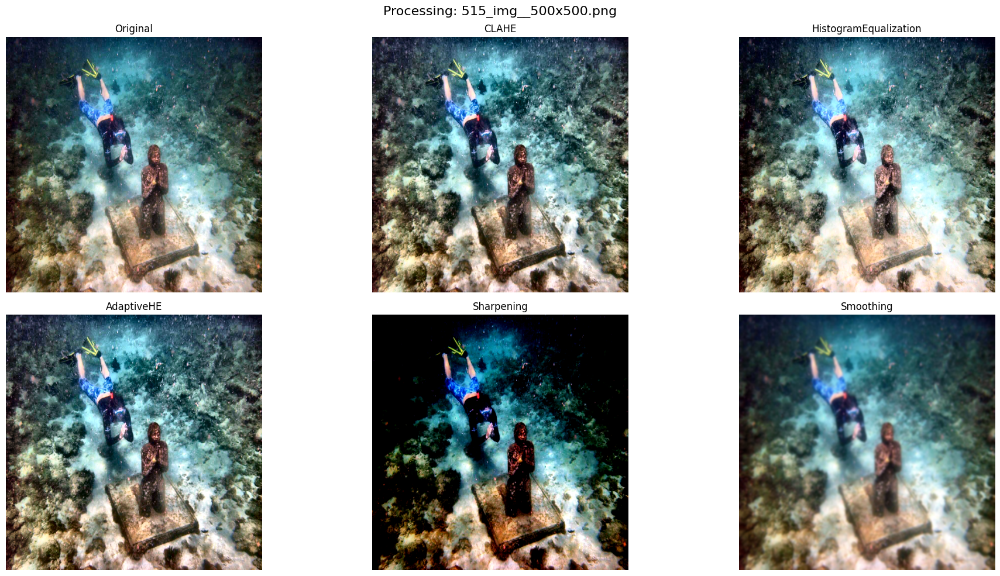

In [ ]:
process_515 = process_and_save_images(image_folder, resized_image_names[0], save_folder)

Gambar disimpan: /content/processed_images/Original/858_img__500x500_Original.png
Gambar disimpan: /content/processed_images/CLAHE/858_img__500x500_CLAHE.png
Gambar disimpan: /content/processed_images/HistogramEqualization/858_img__500x500_HistogramEqualization.png
Gambar disimpan: /content/processed_images/AdaptiveHE/858_img__500x500_AdaptiveHE.png
Gambar disimpan: /content/processed_images/Sharpening/858_img__500x500_Sharpening.png
Gambar disimpan: /content/processed_images/Smoothing/858_img__500x500_Smoothing.png


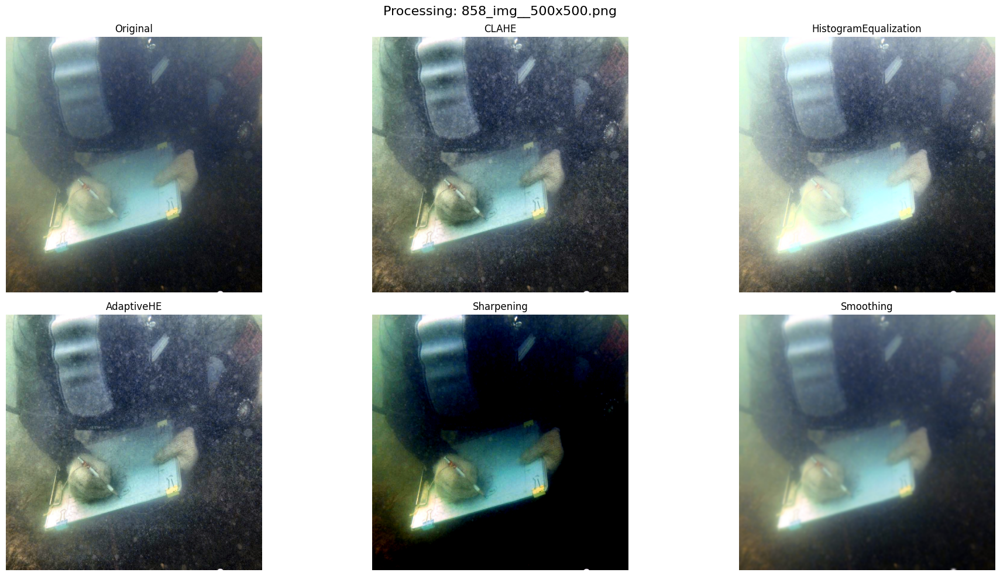

In [ ]:
process_858 = process_and_save_images(image_folder, resized_image_names[1], save_folder)

Gambar disimpan: /content/processed_images/Original/469_img__500x500_Original.png
Gambar disimpan: /content/processed_images/CLAHE/469_img__500x500_CLAHE.png
Gambar disimpan: /content/processed_images/HistogramEqualization/469_img__500x500_HistogramEqualization.png
Gambar disimpan: /content/processed_images/AdaptiveHE/469_img__500x500_AdaptiveHE.png
Gambar disimpan: /content/processed_images/Sharpening/469_img__500x500_Sharpening.png
Gambar disimpan: /content/processed_images/Smoothing/469_img__500x500_Smoothing.png


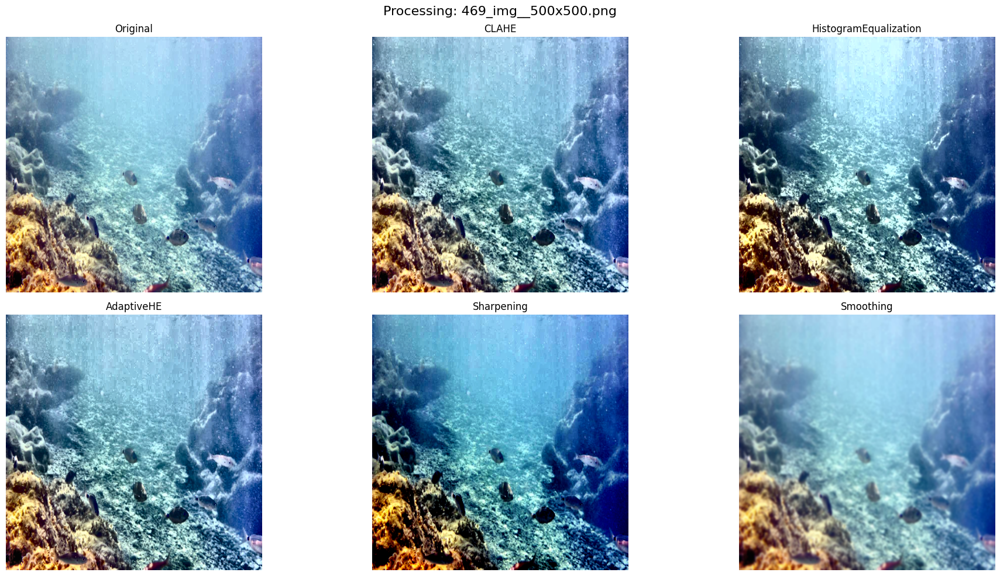

In [ ]:
process_469 = process_and_save_images(image_folder, resized_image_names[2], save_folder)

# Save into Gdrive

In [ ]:
from google.colab import drive
import os
import shutil

def save_image_to_gdrive(image_path, save_path):
    """
    Saves an image from a given path to Google Drive with the same filename.

    Parameters:
    image_path (str): Local path to the image file.
    save_path (str): Folder path inside Google Drive (e.g., 'MyDrive/images/').
    """
    # Mount Google Drive
    drive.mount('/content/drive')

    # Get the filename from the source path
    filename = os.path.basename(image_path)

    # Construct full destination path
    gdrive_path = os.path.join('/content/drive/', save_path)

    # Ensure the directory exists
    os.makedirs(gdrive_path, exist_ok=True)

    # Destination file path
    destination = os.path.join(gdrive_path, filename)

    # Copy the image to Google Drive
    shutil.copy(image_path, destination)

    print(f"Image saved to: {destination}")

In [ ]:
print("Path to dataset files:", path)

Path to dataset files: /root/.cache/kagglehub/datasets/larjeck/uieb-dataset-reference/versions/1


In [ ]:
dataset_path = path + "/reference-890/"

In [ ]:
dataset_path

'/root/.cache/kagglehub/datasets/larjeck/uieb-dataset-reference/versions/1/reference-890'

In [ ]:
image_names = ["515_img_.png", "858_img_.png", "469_img_.png"]

In [ ]:
for image_name in image_names:
  save_image_to_gdrive(dataset_path + image_name, 'MyDrive/under_water/choose_3_blur')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Image saved to: /content/drive/MyDrive/under_water/choose_3_blur/515_img_.png
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Image saved to: /content/drive/MyDrive/under_water/choose_3_blur/858_img_.png
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Image saved to: /content/drive/MyDrive/under_water/choose_3_blur/469_img_.png


In [ ]:
resized_image_names = ["515_img__500x500.png", "858_img__500x500.png", "469_img__500x500.png"]

In [ ]:
for resized_image_name in resized_image_names:
  save_image_to_gdrive('/content/' + resized_image_name, 'MyDrive/under_water/resized_500x500')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Image saved to: /content/drive/MyDrive/under_water/resized_500x500/515_img__500x500.png
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Image saved to: /content/drive/MyDrive/under_water/resized_500x500/858_img__500x500.png
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Image saved to: /content/drive/MyDrive/under_water/resized_500x500/469_img__500x500.png


In [ ]:
process_515, process_858, process_469

(['515_img__500x500_Original.png',
  '515_img__500x500_CLAHE.png',
  '515_img__500x500_HistogramEqualization.png',
  '515_img__500x500_AdaptiveHE.png',
  '515_img__500x500_Sharpening.png',
  '515_img__500x500_Smoothing.png'],
 ['858_img__500x500_Original.png',
  '858_img__500x500_CLAHE.png',
  '858_img__500x500_HistogramEqualization.png',
  '858_img__500x500_AdaptiveHE.png',
  '858_img__500x500_Sharpening.png',
  '858_img__500x500_Smoothing.png'],
 ['469_img__500x500_Original.png',
  '469_img__500x500_CLAHE.png',
  '469_img__500x500_HistogramEqualization.png',
  '469_img__500x500_AdaptiveHE.png',
  '469_img__500x500_Sharpening.png',
  '469_img__500x500_Smoothing.png'])

# Preprocess & save gdrive

In [ ]:
from google.colab import drive
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Mount Google Drive
drive.mount('/content/drive')

def process_and_save_images(image_folder, image_name, save_folder_base):
    """
    Terapkan berbagai algoritma pada satu gambar, tampilkan hasilnya, dan simpan ke folder berdasarkan metode.
    Path format: MyDrive/under_water/preprocess/{method_name}/{image_name}/{image}
    """
    filters = {
        "Original": lambda x: x,
        "CLAHE": apply_clahe,
        "HistogramEqualization": apply_histogram_equalization,
        "AdaptiveHE": apply_adaptive_histogram_equalization,
        "Sharpening": apply_sharpening,
        "Smoothing": apply_smoothing
    }

    # Membaca gambar
    img_path = os.path.join(image_folder, image_name)
    image = cv2.imread(img_path)

    if image is None:
        print(f"Gagal membaca gambar: {image_name}")
        return  # Menghentikan fungsi jika gambar tidak ditemukan

    # Setup plot untuk masing-masing filter
    plt.figure(figsize=(20, 10))
    plt.suptitle(f"Processing: {image_name}", fontsize=16)

    paths = []

    # Loop through each filter method
    for idx, (filter_name, filter_func) in enumerate(filters.items()):
        processed_image = filter_func(image)

        # Construct the method-based folder structure
        method_folder = os.path.join(save_folder_base, filter_name)

        # Create the method folder and subfolders if they don't exist
        os.makedirs(method_folder, exist_ok=True)

        # Save the image in the constructed folder path
        name, ext = os.path.splitext(image_name)
        new_image_name = f"{name}_{filter_name}{ext}"
        print(new_image_name)
        save_path = os.path.join(method_folder, new_image_name)

        # Save the processed image
        cv2.imwrite(save_path, processed_image)
        print(f"Gambar disimpan: {save_path}")

        # Convert from BGR to RGB for displaying with matplotlib
        processed_image_rgb = cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB)

        # Display the image
        plt.subplot(2, 3, idx + 1)
        plt.imshow(processed_image_rgb)
        plt.title(filter_name)
        plt.axis("off")

        # Collect the saved paths (optional)
        paths.append(save_path)

    plt.tight_layout()
    plt.show()

    return paths  # Return all saved image paths


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Example folder and image names
image_folder = "/content/"
resized_image_names = ["515_img__500x500.png", "858_img__500x500.png", "469_img__500x500.png"]
save_folder_base = '/content/drive/MyDrive/under_water/preprocess'  # Base folder in Google Drive

515_img__500x500_Original.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Original/515_img__500x500_Original.png
515_img__500x500_CLAHE.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/CLAHE/515_img__500x500_CLAHE.png
515_img__500x500_HistogramEqualization.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/HistogramEqualization/515_img__500x500_HistogramEqualization.png
515_img__500x500_AdaptiveHE.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/AdaptiveHE/515_img__500x500_AdaptiveHE.png
515_img__500x500_Sharpening.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Sharpening/515_img__500x500_Sharpening.png
515_img__500x500_Smoothing.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Smoothing/515_img__500x500_Smoothing.png


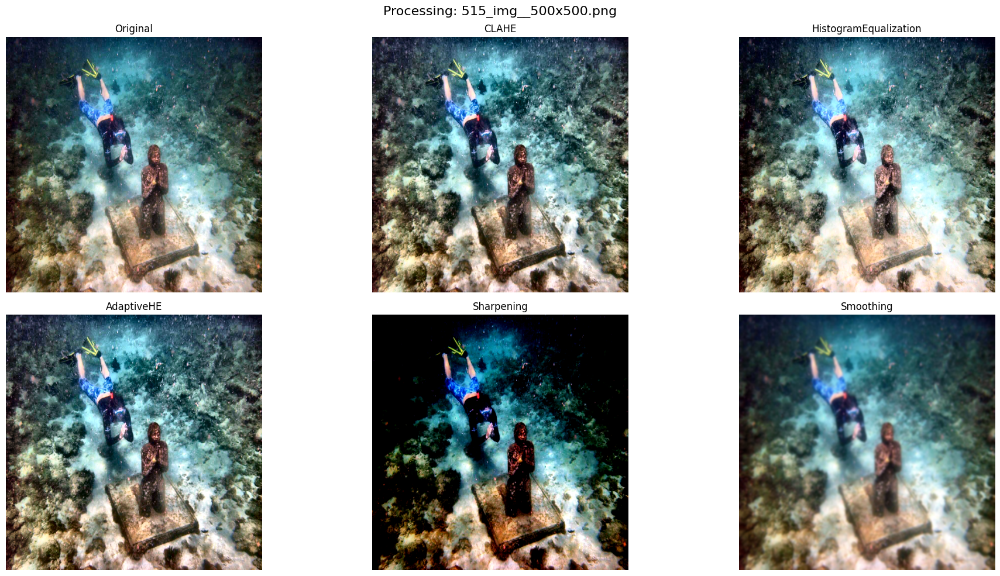

['/content/drive/MyDrive/under_water/preprocess/Original/515_img__500x500_Original.png',
 '/content/drive/MyDrive/under_water/preprocess/CLAHE/515_img__500x500_CLAHE.png',
 '/content/drive/MyDrive/under_water/preprocess/HistogramEqualization/515_img__500x500_HistogramEqualization.png',
 '/content/drive/MyDrive/under_water/preprocess/AdaptiveHE/515_img__500x500_AdaptiveHE.png',
 '/content/drive/MyDrive/under_water/preprocess/Sharpening/515_img__500x500_Sharpening.png',
 '/content/drive/MyDrive/under_water/preprocess/Smoothing/515_img__500x500_Smoothing.png']

In [ ]:
saved_image_paths_515 = process_and_save_images(image_folder, resized_image_names[0], save_folder_base)
saved_image_paths_515

858_img__500x500_Original.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Original/858_img__500x500_Original.png
858_img__500x500_CLAHE.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/CLAHE/858_img__500x500_CLAHE.png
858_img__500x500_HistogramEqualization.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/HistogramEqualization/858_img__500x500_HistogramEqualization.png
858_img__500x500_AdaptiveHE.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/AdaptiveHE/858_img__500x500_AdaptiveHE.png
858_img__500x500_Sharpening.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Sharpening/858_img__500x500_Sharpening.png
858_img__500x500_Smoothing.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Smoothing/858_img__500x500_Smoothing.png


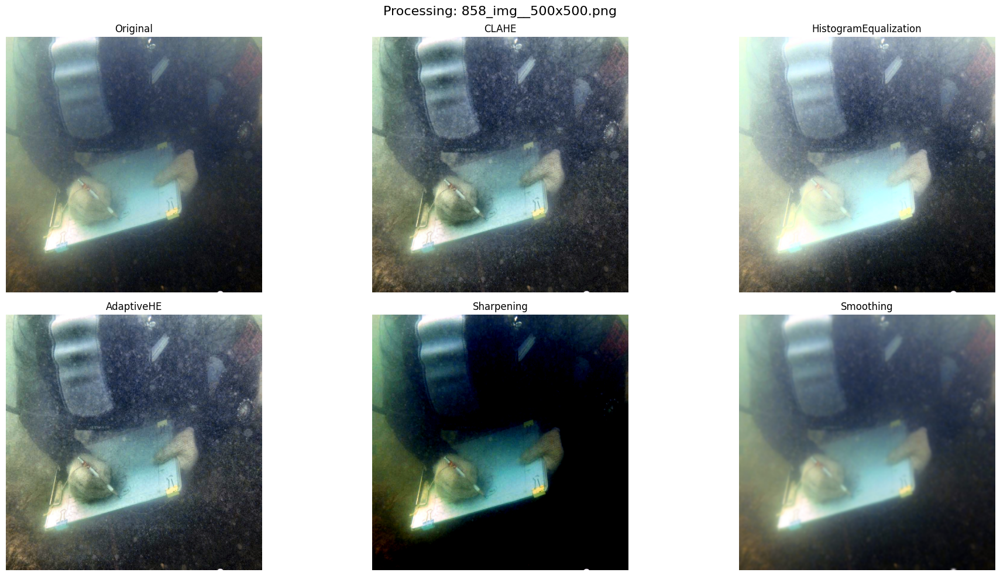

['/content/drive/MyDrive/under_water/preprocess/Original/858_img__500x500_Original.png',
 '/content/drive/MyDrive/under_water/preprocess/CLAHE/858_img__500x500_CLAHE.png',
 '/content/drive/MyDrive/under_water/preprocess/HistogramEqualization/858_img__500x500_HistogramEqualization.png',
 '/content/drive/MyDrive/under_water/preprocess/AdaptiveHE/858_img__500x500_AdaptiveHE.png',
 '/content/drive/MyDrive/under_water/preprocess/Sharpening/858_img__500x500_Sharpening.png',
 '/content/drive/MyDrive/under_water/preprocess/Smoothing/858_img__500x500_Smoothing.png']

In [ ]:
saved_image_paths_858 = process_and_save_images(image_folder, resized_image_names[1], save_folder_base)
saved_image_paths_858

469_img__500x500_Original.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Original/469_img__500x500_Original.png
469_img__500x500_CLAHE.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/CLAHE/469_img__500x500_CLAHE.png
469_img__500x500_HistogramEqualization.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/HistogramEqualization/469_img__500x500_HistogramEqualization.png
469_img__500x500_AdaptiveHE.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/AdaptiveHE/469_img__500x500_AdaptiveHE.png
469_img__500x500_Sharpening.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Sharpening/469_img__500x500_Sharpening.png
469_img__500x500_Smoothing.png
Gambar disimpan: /content/drive/MyDrive/under_water/preprocess/Smoothing/469_img__500x500_Smoothing.png


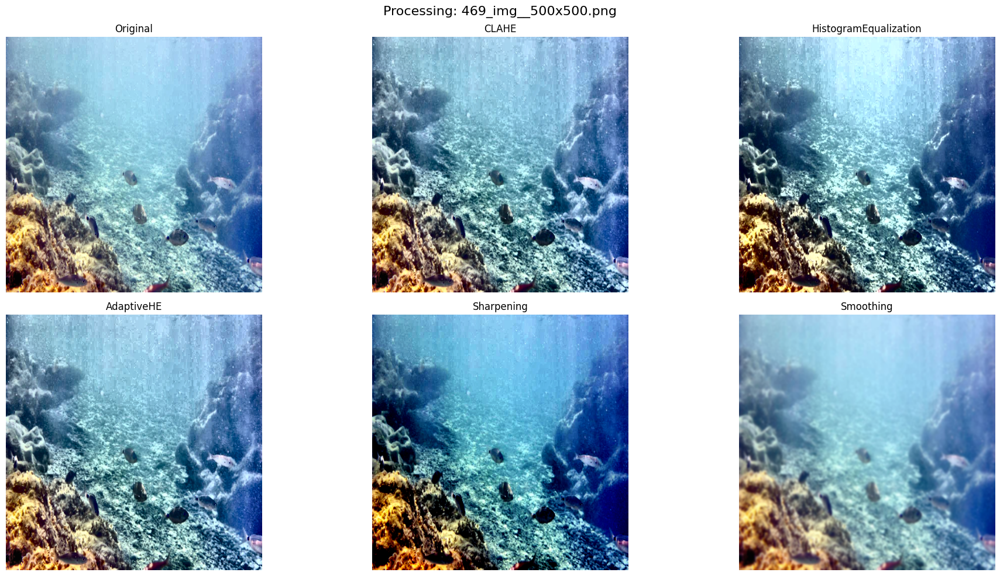

['/content/drive/MyDrive/under_water/preprocess/Original/469_img__500x500_Original.png',
 '/content/drive/MyDrive/under_water/preprocess/CLAHE/469_img__500x500_CLAHE.png',
 '/content/drive/MyDrive/under_water/preprocess/HistogramEqualization/469_img__500x500_HistogramEqualization.png',
 '/content/drive/MyDrive/under_water/preprocess/AdaptiveHE/469_img__500x500_AdaptiveHE.png',
 '/content/drive/MyDrive/under_water/preprocess/Sharpening/469_img__500x500_Sharpening.png',
 '/content/drive/MyDrive/under_water/preprocess/Smoothing/469_img__500x500_Smoothing.png']

In [ ]:
saved_image_paths_469 = process_and_save_images(image_folder, resized_image_names[2], save_folder_base)
saved_image_paths_469